In [2]:
# from google.colab import drive
# drive.mount('/content/drive')
# %cd drive/MyDrive/diplomatikh/GANMedicalImageGeneration

In [3]:
from utils import BreastCancerDataset, Visualizer,generate_fixed_random_tensor
from models.train import train_GAN
from models.bases.generator_base import GeneratorBase
import torch
import torch.nn as nn
import os

In [4]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
SLICED_FOLDER = '../sliced'
MODELS_FOLDER= '../step_by_step'
GENERATOR_PATH = os.path.join(MODELS_FOLDER,'generator.pth')
DISCRIMINATOR_PATH = os.path.join(MODELS_FOLDER,'discriminator.pth')
BATCHE_SIZE = 1
GEN_LEARNING_RATE =1e-5
DISC_LEARNING_RATE = 1e-5
REINITIALIZE_MODELS = False


In [5]:
visualizer = Visualizer()
dataset=BreastCancerDataset(sliced_folder=SLICED_FOLDER)
dataloader=  torch.utils.data.DataLoader(dataset, batch_size=BATCHE_SIZE, shuffle=True, num_workers=0)

In [6]:
class Discriminator(nn.Module):
    def __init__(self,path,features=16,block_numbers=4):
        super(Discriminator,self).__init__()
        self.path= path
        self.disc =  nn.Sequential(
            nn.Conv3d(2,features,4,2,1),
            nn.LeakyReLU(0.2),
            *[self._block(features* 2**i,features*2**(i+1),4,2,1) for i in range(block_numbers)],
            nn.Conv3d(features*2**(block_numbers),1,(10,10,4),2,1),
            nn.Sigmoid()

        )
    def _block(self,in_channels,out_channels,kernel_size,stride,padding):
        return nn.Sequential(
            nn.Conv3d(in_channels,out_channels,kernel_size,stride,padding,bias=False),
            nn.BatchNorm3d(out_channels),
            nn.LeakyReLU(0.2)
        )
        
    def forward(self,x):
        return self.disc(x).view(-1)
                      
        

In [7]:
class Generator(GeneratorBase):
    def __init__(self,path,features=16,block_numbers=3):
        super(Generator, self).__init__()
        self.noise_shape = (2,8,8,2)
        self.path = path
        channels= 2
        self.gen =  nn.Sequential(
            self._block(2,features*2**(block_numbers),4,2,1),
            *[self._block(features* 2**(block_numbers-i),features*2**(block_numbers-i-1),4,2,1) for i in range(block_numbers)],
            self._block(features,2,4,2,1),
            nn.Sigmoid()
        )
    def _block(self,in_channels,out_channels,kernel_size,stride,padding):
        return nn.Sequential(
            nn.ConvTranspose3d(in_channels,out_channels,kernel_size,stride,padding,bias=False),
            nn.BatchNorm3d(out_channels),
            nn.ReLU()
        )
    def forward(self, x):
        x = self.gen(x)
        x = x-0.5
        return x

In [13]:
def initialize_weights(model,mean=0.0,std=0.2):
    for m in model.modules():
        if isinstance(m,(nn.Conv3d,nn.ConvTranspose3d,nn.BatchNorm3d)):
            nn.init.normal_(m.weight.data,mean,std)

In [9]:
generator = Generator(path=GENERATOR_PATH).to(device)
discriminator = Discriminator(path=DISCRIMINATOR_PATH).to(device)



gen_optimizer = torch.optim.Adam(generator.parameters(), lr=GEN_LEARNING_RATE,betas=(0.5,0.999) )
disc_optimizer = torch.optim.Adam(discriminator.parameters(), lr=DISC_LEARNING_RATE,betas=(0.5,0.999))
loss_function = nn.BCELoss()

In [10]:
CONSTANT_NOISE=  generate_fixed_random_tensor(0,generator.noise_shape,device=device)

In [11]:
if not REINITIALIZE_MODELS:
  try:
      generator.load_state_dict(torch.load(generator.path,map_location=torch.device(device)))
      discriminator.load_state_dict(torch.load(discriminator.path,map_location=torch.device(device)))
      print("Weights loaded")
  except:
      os.makedirs(MODELS_FOLDER,exist_ok=True)
      print("No weights found")
else:
    input('Are you sure you want to reinitialize?')


No weights found


In [12]:
def see_resutls(noise):
    output = generator(noise)[0]
    img,mask = output[0],output[1]
    visualizer.visualize_distribution(img)
    visualizer.visualize_distribution(mask)
    visualizer(img,mask)

mean: tensor(0.4974)
std: tensor(0.0005)


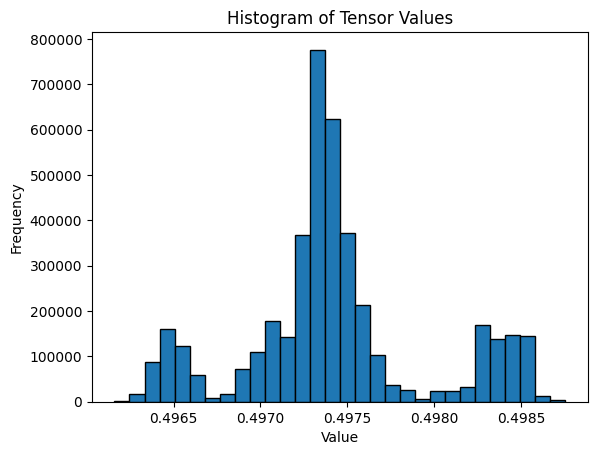

mean: tensor(0.4976)
std: tensor(0.0007)


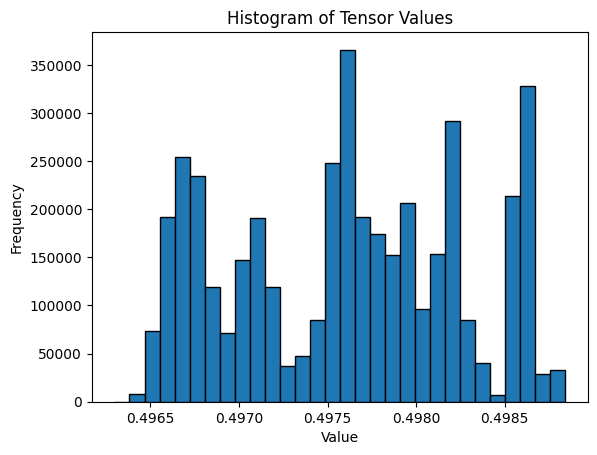

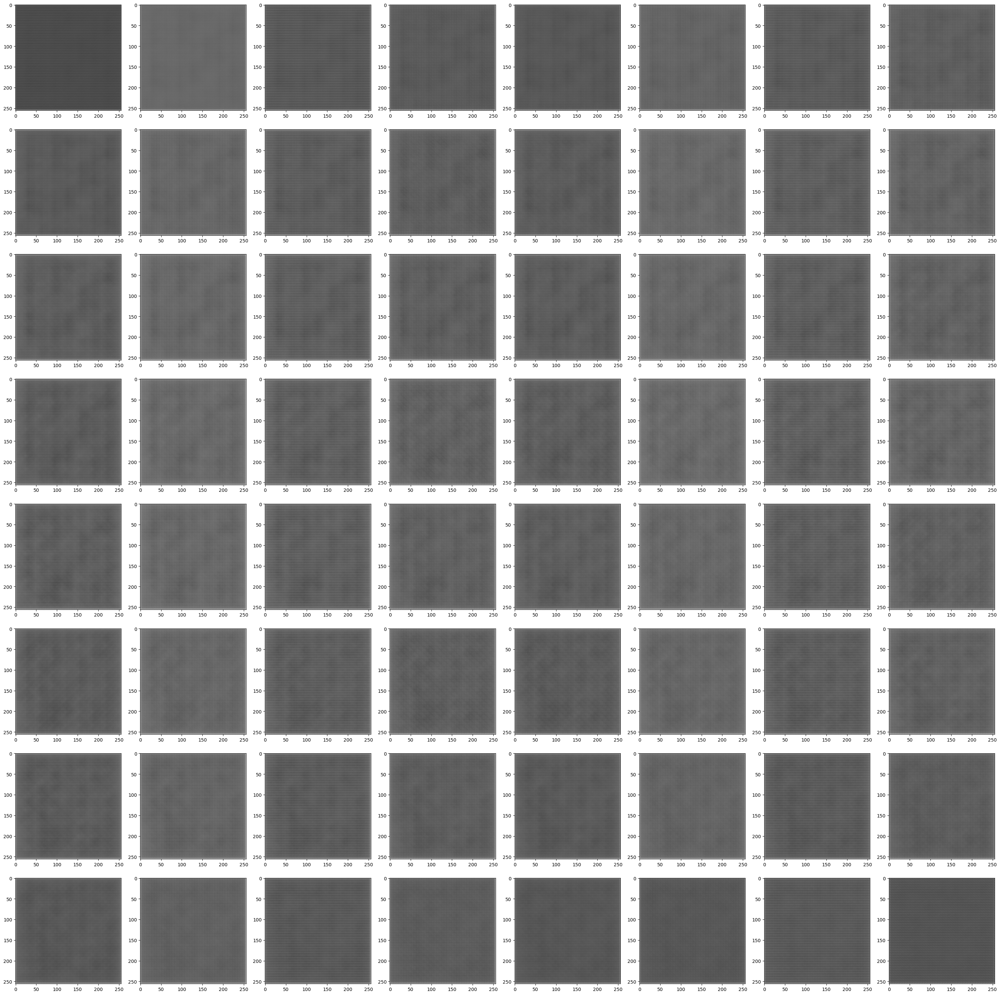

In [9]:
see_resutls(CONSTANT_NOISE)

In [ ]:
epochs=1000
save_frequency = 1
versbose_frequency = 1000
generator_epochs = 20

def train_GAN(generator,
              discriminator,
              gen_optimizer,
              disc_optimizer,
              loss_function,
              dataloader,
              epochs,
              generator_epochs,
              device,
              save_frequency=1,
              versbose_frequency=1000):
    noise_shape = generator.noise_shape

    for epoch in range(epochs):
        epoch_generator_loss =0 
        epoch_discriminator_loss = 0
        
        for i,real_images in enumerate(dataloader):

            real_images = real_images.to(device)
            batch_size = real_images.shape[0]
            noise  = torch.randn(batch_size, *noise_shape, device=device)
            # DISCRIMINATOR TRAIN
            fake_images = generator(noise)

            discriminator_real_output  = discriminator(real_images).view(-1)
            discriminator_real_loss = loss_function(discriminator_real_output,torch.ones_like(discriminator_real_output))
            
            discriminator_fake_output = discriminator(fake_images).view(-1)
            discriminator_fake_loss = loss_function(discriminator_fake_output,torch.zeros_like(discriminator_fake_output))

            discriminator_loss = (discriminator_real_loss+discriminator_fake_loss)/2
            disc_optimizer.zero_grad()
            discriminator_loss.backward()
            disc_optimizer.step()
            
            # GENERATOR TRAIN
            for _ in range(generator_epochs):
                fake_images = generator(noise)
                fake_output=discriminator(fake_images).view(-1)
                generator_loss =  loss_function(fake_output,torch.ones_like(fake_output))
                gen_optimizer.zero_grad()
                generator_loss.backward()
                gen_optimizer.step()
            
            epoch_generator_loss  +=generator_loss.item()
            epoch_discriminator_loss +=discriminator_loss.item()
            
            if i % save_frequency ==0 :
                torch.save(generator.state_dict(), generator.path)
                torch.save(discriminator.state_dict(), discriminator.path)
            if i % versbose_frequency ==0 :
                if i !=0:
                    print(f"Sample: {i} Generator Loss: {generator_loss.item()} Discriminator Loss: {discriminator_loss.item()}")

        print(f"Epoch :{epoch+1}/{epochs}\tGenerator Loss: {epoch_generator_loss/len(dataloader)} \tDiscriminator Loss: {epoch_discriminator_loss/len(dataloader)}")      



Sample 9 Generator Loss: 26.494449615478516 Discriminator Loss: 1.5555421534196867e-12


mean: tensor(0.4947)
std: tensor(0.0012)


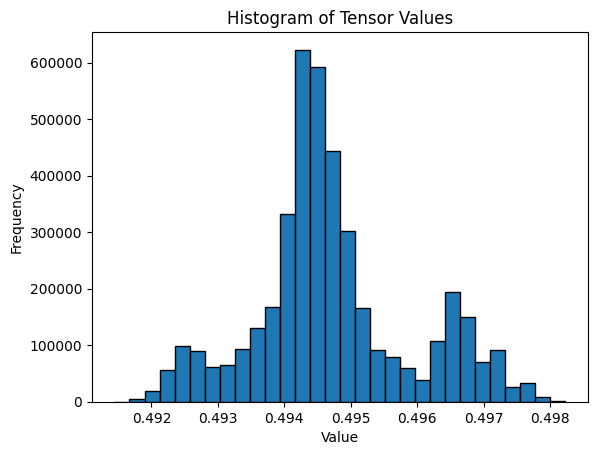

mean: tensor(0.4950)
std: tensor(0.0014)


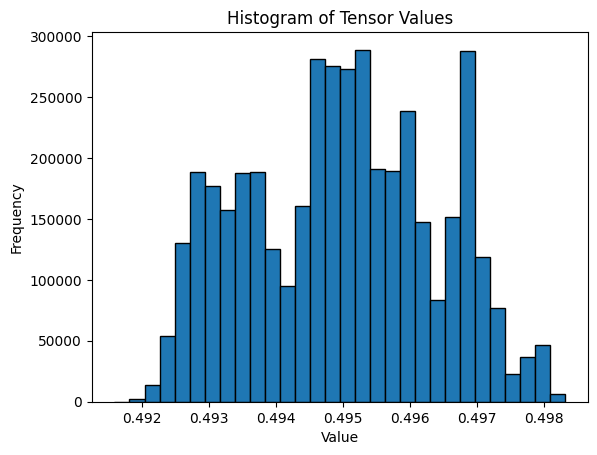

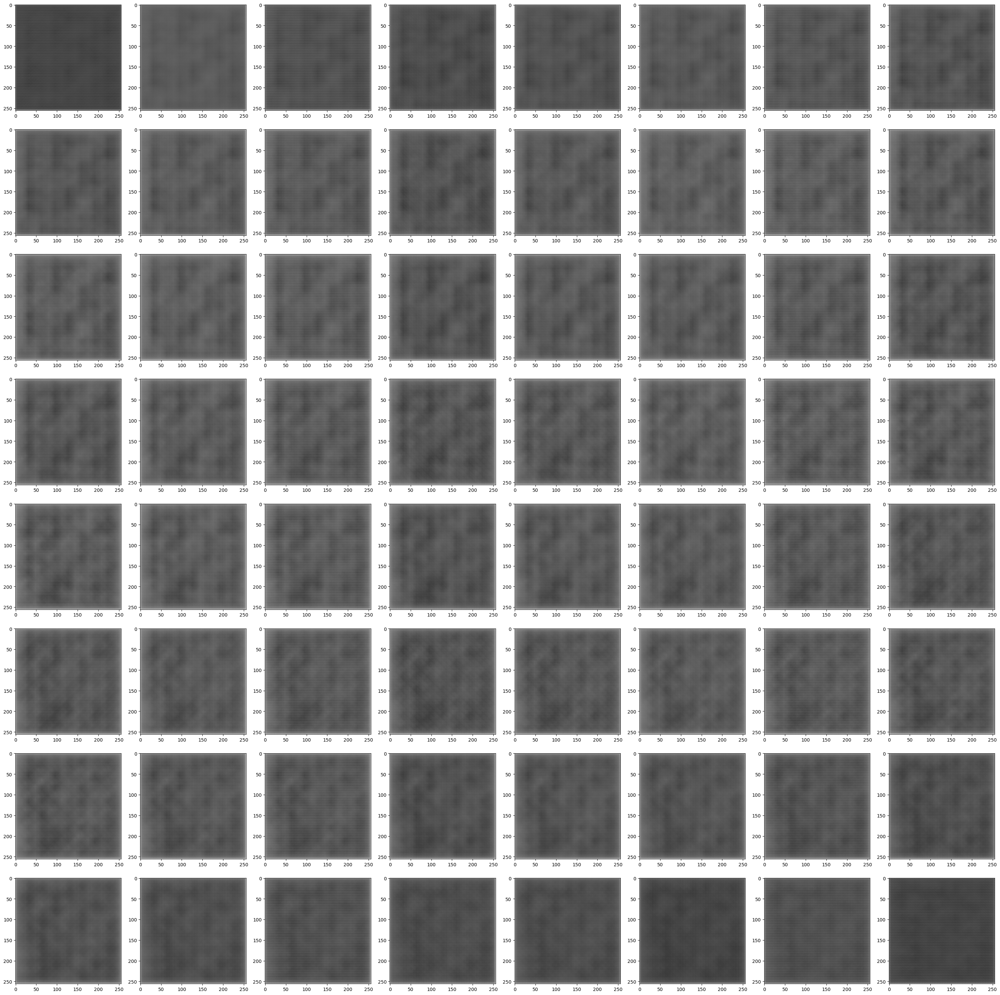

In [15]:
see_resutls(CONSTANT_NOISE)